### Look at rates of cellular exchange. Do initial positions predict final?

In [1]:
import os
import pandas as pd
import numpy as np
import trimesh

# Load test dataset that used Kikume NLS marker
root = "E:\\Nick\\Cole Trapnell's Lab Dropbox\\Nick Lammers\\Nick\\killi_tracker\\"
experiment_date = "20240611_NLS-Kikume_24hpf_side2"
config_name = "tracking_jordao_20240918.txt"
model ="LCP-Multiset-v1"
tracking_folder = config_name.replace(".txt", "")
tracking_folder = tracking_folder.replace(".toml", "")

well_num = 0
start_i = 0
stop_i = 1600

suffix = ""

# get path to metadata
metadata_path = os.path.join(root, "metadata", "tracking")

# set output path for tracking results
project_path = os.path.join(root, "tracking", experiment_date,  tracking_folder, f"well{well_num:04}" + suffix, "")
project_sub_path = os.path.join(project_path, f"track_{start_i:04}" + f"_{stop_i:04}" + suffix, "")

# load the tracks 
deep_tracks_df = pd.read_csv(os.path.join(project_sub_path, "deep_tracks_df.csv"))
deep_tracks_df.head()

# load sphere mesh
sphere_mesh = trimesh.load(os.path.join(project_sub_path, "embryo_sphere_mesh.obj"))

In [2]:
# Import FTLE function
import sys 
repo_path = "C:/Users/nlammers/Projects/CoherentStructures"
sys.path.append(repo_path)

from functions.hyperbolic import HyperbolicLCS_3D

### Attempt to run FTLE on cell Tracks

In [3]:
def get_lcs_data(tracks_df, t_start, t_stop, window=1):
    
    start_range = np.arange(t_start-window, t_start+window+1)
    stop_range = np.arange(t_stop-window, t_stop+window+1)
    # find tracks that span the period of interst
    start_df = tracks_df.loc[np.isin(tracks_df["t"], start_range), ["track_id", "xs", "ys","zs"]].drop_duplicates(subset="track_id")
    stop_df = tracks_df.loc[np.isin(tracks_df["t"], stop_range), ["track_id", "xs", "ys","zs"]].rename(columns={"xs":"xf", "ys":"yf", "zs":"zf"}).drop_duplicates(subset="track_id")

    # merge
    both_df = start_df.merge(stop_df, how="inner", on="track_id")

    # generate outputs
    XP = both_df[["xs", "xf"]].to_numpy()
    YP = both_df[["ys", "yf"]].to_numpy()
    ZP = both_df[["zs", "zf"]].to_numpy()
    TV = np.asarray([t_start, t_stop])
    
    both_df["t_start"] = t_start
    both_df["t_stop"] = t_stop
    
    return XP, YP, ZP, TV, both_df

In [34]:
from tqdm import tqdm

t_delta = int(60*60/123.11)
t0 = 0
t1 = 1589

# Parameters
direction = 'forward'
eps = 100

df_list = []
for t_start in tqdm(range(t0, t1)):
#     t_start = 1300 # shortly after completion of epibole
    t_stop = t_start + t_delta

    xP, yP, zP, tv, df = get_lcs_data(deep_tracks_df, t_start, t_stop, window=1)
    
    # Compute forward hyperbolic LCS
    FTLE_f = HyperbolicLCS_3D(xP,yP,zP,tv,"forward",eps)
    FTLE_b = HyperbolicLCS_3D(xP,yP,zP,tv,"backward",eps)
    df["FTLE_f"] = FTLE_f
    df["FTLE_b"] = FTLE_b
    
    df_list.append(df)
    

100%|██████████| 18/18 [00:00<00:00, 4501.94it/s]

100%|██████████| 18/18 [00:00<00:00, 4500.06it/s]

100%|██████████| 20/20 [00:00<00:00, 5000.06it/s]

100%|██████████| 20/20 [00:00<00:00, 4998.28it/s]

100%|██████████| 20/20 [00:00<00:00, 5000.66it/s]

100%|██████████| 20/20 [00:00<00:00, 5000.66it/s]

100%|██████████| 20/20 [00:00<00:00, 5000.06it/s]

100%|██████████| 21/21 [00:00<00:00, 4200.71it/s]

100%|██████████| 21/21 [00:00<00:00, 3500.53it/s]

100%|██████████| 21/21 [00:00<00:00, 5251.95it/s]

100%|██████████| 21/21 [00:00<00:00, 6998.84it/s]

100%|██████████| 21/21 [00:00<00:00, 5252.57it/s]

100%|██████████| 20/20 [00:00<00:00, 5000.06it/s]

100%|██████████| 20/20 [00:00<00:00, 4001.05it/s]

100%|██████████| 20/20 [00:00<00:00, 4997.38it/s]

100%|██████████| 20/20 [00:00<00:00, 5000.66it/s]

100%|██████████| 20/20 [00:00<00:00, 4999.77it/s]

100%|██████████| 20/20 [00:00<00:00, 4000.29it/s]

100%|██████████| 20/20 [00:00<00:00, 5001.26it/s]

100%|██████████| 20/20 [00:00<0

100%|██████████| 20/20 [00:00<00:00, 4001.24it/s]

100%|██████████| 20/20 [00:00<00:00, 5000.66it/s]

100%|██████████| 19/19 [00:00<00:00, 6335.81it/s]

100%|██████████| 19/19 [00:00<00:00, 6333.29it/s]

100%|██████████| 19/19 [00:00<00:00, 6333.29it/s]

100%|██████████| 19/19 [00:00<00:00, 6332.28it/s]

100%|██████████| 19/19 [00:00<00:00, 4750.06it/s]

100%|██████████| 18/18 [00:00<00:00, 6000.91it/s]

100%|██████████| 18/18 [00:00<00:00, 4499.79it/s]

100%|██████████| 17/17 [00:00<00:00, 4250.81it/s]

100%|██████████| 17/17 [00:00<00:00, 5664.38it/s]

100%|██████████| 17/17 [00:00<00:00, 4251.07it/s]

100%|██████████| 17/17 [00:00<00:00, 5670.68it/s]

100%|██████████| 17/17 [00:00<00:00, 5668.43it/s]

100%|██████████| 17/17 [00:00<00:00, 5665.73it/s]

100%|██████████| 16/16 [00:00<00:00, 5333.30it/s]

100%|██████████| 16/16 [00:00<00:00, 5334.14it/s]

100%|██████████| 17/17 [00:00<00:00, 4248.03it/s]

100%|██████████| 17/17 [00:00<00:00, 4250.31it/s]

100%|██████████| 17/17 [00:00<0

100%|██████████| 41/41 [00:00<00:00, 5126.44it/s]

100%|██████████| 40/40 [00:00<00:00, 5000.51it/s]

100%|██████████| 40/40 [00:00<00:00, 5001.55it/s]

100%|██████████| 43/43 [00:00<00:00, 5375.23it/s]

100%|██████████| 43/43 [00:00<00:00, 5375.39it/s]

100%|██████████| 45/45 [00:00<00:00, 5000.36it/s]

100%|██████████| 47/47 [00:00<00:00, 5221.91it/s]

100%|██████████| 47/47 [00:00<00:00, 5875.78it/s]

100%|██████████| 48/48 [00:00<00:00, 6001.15it/s]

100%|██████████| 48/48 [00:00<00:00, 6001.51it/s]

100%|██████████| 48/48 [00:00<00:00, 5333.58it/s]

100%|██████████| 50/50 [00:00<00:00, 4546.08it/s]

100%|██████████| 50/50 [00:00<00:00, 5556.40it/s]

100%|██████████| 49/49 [00:00<00:00, 5443.97it/s]

100%|██████████| 49/49 [00:00<00:00, 5445.70it/s]

100%|██████████| 48/48 [00:00<00:00, 5333.86it/s]

100%|██████████| 49/49 [00:00<00:00, 5445.42it/s]

100%|██████████| 49/49 [00:00<00:00, 4900.00it/s]

100%|██████████| 48/48 [00:00<00:00, 4363.95it/s]

100%|██████████| 48/48 [00:00<0

100%|██████████| 58/58 [00:00<00:00, 5272.88it/s]

100%|██████████| 55/55 [00:00<00:00, 5500.53it/s]

100%|██████████| 55/55 [00:00<00:00, 6111.88it/s]

100%|██████████| 54/54 [00:00<00:00, 5399.75it/s]

100%|██████████| 54/54 [00:00<00:00, 5399.88it/s]

100%|██████████| 53/53 [00:00<00:00, 5301.02it/s]

100%|██████████| 52/52 [00:00<00:00, 4726.49it/s]

100%|██████████| 52/52 [00:00<00:00, 5778.50it/s]

100%|██████████| 54/54 [00:00<00:00, 5400.65it/s]

100%|██████████| 54/54 [00:00<00:00, 4909.55it/s]

100%|██████████| 56/56 [00:00<00:00, 4666.17it/s]

100%|██████████| 55/55 [00:00<00:00, 4999.50it/s]

100%|██████████| 55/55 [00:00<00:00, 5500.01it/s]

100%|██████████| 54/54 [00:00<00:00, 4908.60it/s]

100%|██████████| 54/54 [00:00<00:00, 5400.52it/s]

100%|██████████| 53/53 [00:00<00:00, 4817.90it/s]

100%|██████████| 54/54 [00:00<00:00, 4499.88it/s]

100%|██████████| 54/54 [00:00<00:00, 4908.60it/s]

100%|██████████| 52/52 [00:00<00:00, 5777.13it/s]

100%|██████████| 52/52 [00:00<0

100%|██████████| 72/72 [00:00<00:00, 4800.20it/s]

100%|██████████| 72/72 [00:00<00:00, 5538.86it/s]

100%|██████████| 72/72 [00:00<00:00, 4800.27it/s]

100%|██████████| 72/72 [00:00<00:00, 5143.23it/s]

100%|██████████| 72/72 [00:00<00:00, 5539.07it/s]

100%|██████████| 72/72 [00:00<00:00, 5143.23it/s]

100%|██████████| 73/73 [00:00<00:00, 4866.71it/s]

100%|██████████| 73/73 [00:00<00:00, 5214.84it/s]

100%|██████████| 73/73 [00:00<00:00, 4866.63it/s]

100%|██████████| 73/73 [00:00<00:00, 5215.46it/s]

100%|██████████| 73/73 [00:00<00:00, 5616.41it/s]

100%|██████████| 74/74 [00:00<00:00, 4625.34it/s]

100%|██████████| 79/79 [00:00<00:00, 4937.12it/s]

100%|██████████| 79/79 [00:00<00:00, 5267.05it/s]

100%|██████████| 80/80 [00:00<00:00, 5000.36it/s]

100%|██████████| 82/82 [00:00<00:00, 5125.14it/s]

100%|██████████| 82/82 [00:00<00:00, 5125.60it/s]

100%|██████████| 80/80 [00:00<00:00, 5000.06it/s]

100%|██████████| 75/75 [00:00<00:00, 5357.26it/s]

100%|██████████| 75/75 [00:00<0

100%|██████████| 70/70 [00:00<00:00, 5834.34it/s]

100%|██████████| 70/70 [00:00<00:00, 5833.64it/s]

100%|██████████| 70/70 [00:00<00:00, 5833.87it/s]

100%|██████████| 71/71 [00:00<00:00, 5461.13it/s]

100%|██████████| 71/71 [00:00<00:00, 5461.83it/s]

100%|██████████| 72/72 [00:00<00:00, 5539.17it/s]

100%|██████████| 72/72 [00:00<00:00, 5539.07it/s]

100%|██████████| 72/72 [00:00<00:00, 5143.23it/s]

100%|██████████| 75/75 [00:00<00:00, 5000.20it/s]

100%|██████████| 77/77 [00:00<00:00, 5500.68it/s]

100%|██████████| 77/77 [00:00<00:00, 5921.99it/s]

100%|██████████| 76/76 [00:00<00:00, 5066.39it/s]

100%|██████████| 75/75 [00:00<00:00, 5000.12it/s]

100%|██████████| 75/75 [00:00<00:00, 5769.54it/s]

100%|██████████| 75/75 [00:00<00:00, 4999.89it/s]

100%|██████████| 75/75 [00:00<00:00, 5356.62it/s]

100%|██████████| 75/75 [00:00<00:00, 5769.86it/s]

100%|██████████| 78/78 [00:00<00:00, 5201.20it/s]

100%|██████████| 73/73 [00:00<00:00, 5615.48it/s]

100%|██████████| 73/73 [00:00<0

100%|██████████| 90/90 [00:00<00:00, 5999.58it/s]

100%|██████████| 90/90 [00:00<00:00, 6001.01it/s]

100%|██████████| 90/90 [00:00<00:00, 6000.34it/s]

100%|██████████| 91/91 [00:00<00:00, 5687.66it/s]

100%|██████████| 91/91 [00:00<00:00, 6067.20it/s]

100%|██████████| 89/89 [00:00<00:00, 5235.23it/s]

100%|██████████| 89/89 [00:00<00:00, 5235.23it/s]

100%|██████████| 89/89 [00:00<00:00, 5933.29it/s]

100%|██████████| 89/89 [00:00<00:00, 5562.49it/s]

100%|██████████| 87/87 [00:00<00:00, 5437.57it/s]

100%|██████████| 87/87 [00:00<00:00, 6213.89it/s]

100%|██████████| 89/89 [00:00<00:00, 5933.76it/s]

100%|██████████| 89/89 [00:00<00:00, 5933.57it/s]

100%|██████████| 89/89 [00:00<00:00, 5933.95it/s]

100%|██████████| 90/90 [00:00<00:00, 5999.96it/s]

100%|██████████| 91/91 [00:00<00:00, 5352.43it/s]

100%|██████████| 91/91 [00:00<00:00, 5688.68it/s]

100%|██████████| 89/89 [00:00<00:00, 5562.82it/s]

100%|██████████| 90/90 [00:00<00:00, 5294.13it/s]

100%|██████████| 90/90 [00:00<0

100%|██████████| 109/109 [00:00<00:00, 5736.68it/s]

100%|██████████| 109/109 [00:00<00:00, 5450.14it/s]

100%|██████████| 114/114 [00:00<00:00, 5700.01it/s]

100%|██████████| 113/113 [00:00<00:00, 5649.87it/s]

100%|██████████| 113/113 [00:00<00:00, 5650.21it/s]

100%|██████████| 109/109 [00:00<00:00, 5737.40it/s]

100%|██████████| 106/106 [00:00<00:00, 5300.07it/s]

100%|██████████| 106/106 [00:00<00:00, 6235.40it/s]

100%|██████████| 107/107 [00:00<00:00, 5944.56it/s]

100%|██████████| 108/108 [00:00<00:00, 5684.48it/s]

100%|██████████| 108/108 [00:00<00:00, 6000.51it/s]

100%|██████████| 108/108 [00:00<00:00, 5685.34it/s]

100%|██████████| 109/109 [00:00<00:00, 5190.09it/s]

100%|██████████| 109/109 [00:00<00:00, 5737.47it/s]

100%|██████████| 113/113 [00:00<00:00, 5650.07it/s]

100%|██████████| 114/114 [00:00<00:00, 5700.55it/s]

100%|██████████| 114/114 [00:00<00:00, 5428.78it/s]

100%|██████████| 114/114 [00:00<00:00, 5999.91it/s]

100%|██████████| 113/113 [00:00<00:00, 5136.12

100%|██████████| 133/133 [00:00<00:00, 5782.43it/s]

100%|██████████| 133/133 [00:00<00:00, 5782.13it/s]

100%|██████████| 131/131 [00:00<00:00, 5458.30it/s]

100%|██████████| 135/135 [00:00<00:00, 5869.99it/s]

100%|██████████| 135/135 [00:00<00:00, 6136.68it/s]

100%|██████████| 134/134 [00:00<00:00, 5583.90it/s]

100%|██████████| 130/130 [00:00<00:00, 5652.35it/s]

100%|██████████| 130/130 [00:00<00:00, 5652.23it/s]

100%|██████████| 129/129 [00:00<00:00, 5608.81it/s]

100%|██████████| 131/131 [00:00<00:00, 5457.92it/s]

100%|██████████| 131/131 [00:00<00:00, 5458.19it/s]

100%|██████████| 130/130 [00:00<00:00, 5652.53it/s]

100%|██████████| 130/130 [00:00<00:00, 5652.11it/s]

100%|██████████| 130/130 [00:00<00:00, 5416.68it/s]

100%|██████████| 130/130 [00:00<00:00, 5417.01it/s]

100%|██████████| 133/133 [00:00<00:00, 5115.47it/s]

100%|██████████| 133/133 [00:00<00:00, 5541.35it/s]

100%|██████████| 134/134 [00:00<00:00, 5360.03it/s]

100%|██████████| 133/133 [00:00<00:00, 5319.93

100%|██████████| 139/139 [00:00<00:00, 5148.11it/s]

100%|██████████| 139/139 [00:00<00:00, 5560.30it/s]

100%|██████████| 138/138 [00:00<00:00, 5520.14it/s]

100%|██████████| 139/139 [00:00<00:00, 5559.61it/s]

100%|██████████| 139/139 [00:00<00:00, 5559.66it/s]

100%|██████████| 138/138 [00:00<00:00, 5748.93it/s]

100%|██████████| 138/138 [00:00<00:00, 5749.67it/s]

100%|██████████| 138/138 [00:00<00:00, 6000.00it/s]

100%|██████████| 138/138 [00:00<00:00, 5750.30it/s]

100%|██████████| 138/138 [00:00<00:00, 5520.24it/s]

100%|██████████| 138/138 [00:00<00:00, 5999.94it/s]

100%|██████████| 146/146 [00:00<00:00, 5407.61it/s]

100%|██████████| 151/151 [00:00<00:00, 5592.90it/s]

100%|██████████| 151/151 [00:00<00:00, 5592.45it/s]

100%|██████████| 156/156 [00:00<00:00, 5379.74it/s]

100%|██████████| 156/156 [00:00<00:00, 5379.35it/s]

100%|██████████| 156/156 [00:00<00:00, 5571.36it/s]

100%|██████████| 157/157 [00:00<00:00, 5414.01it/s]

100%|██████████| 155/155 [00:00<00:00, 5535.64

100%|██████████| 169/169 [00:00<00:00, 5120.81it/s]

100%|██████████| 172/172 [00:00<00:00, 5212.27it/s]

100%|██████████| 167/167 [00:00<00:00, 5387.16it/s]

100%|██████████| 167/167 [00:00<00:00, 5218.86it/s]

100%|██████████| 164/164 [00:00<00:00, 5290.42it/s]

100%|██████████| 163/163 [00:00<00:00, 5433.42it/s]

100%|██████████| 163/163 [00:00<00:00, 5258.12it/s]

100%|██████████| 162/162 [00:00<00:00, 5400.05it/s]

100%|██████████| 161/161 [00:00<00:00, 5366.84it/s]

100%|██████████| 161/161 [00:00<00:00, 5193.69it/s]

100%|██████████| 163/163 [00:00<00:00, 5257.84it/s]

100%|██████████| 161/161 [00:00<00:00, 5366.63it/s]

100%|██████████| 161/161 [00:00<00:00, 5366.50it/s]

100%|██████████| 157/157 [00:00<00:00, 5413.78it/s]

100%|██████████| 160/160 [00:00<00:00, 5160.95it/s]

100%|██████████| 160/160 [00:00<00:00, 5333.42it/s]

100%|██████████| 157/157 [00:00<00:00, 5413.87it/s]

100%|██████████| 161/161 [00:00<00:00, 5366.59it/s]

100%|██████████| 161/161 [00:00<00:00, 5366.84

100%|██████████| 170/170 [00:00<00:00, 5483.97it/s]

100%|██████████| 164/164 [00:00<00:00, 5655.16it/s]

100%|██████████| 164/164 [00:00<00:00, 5857.12it/s]

100%|██████████| 166/166 [00:00<00:00, 5723.94it/s]

100%|██████████| 164/164 [00:00<00:00, 5655.02it/s]

100%|██████████| 164/164 [00:00<00:00, 5655.30it/s]

100%|██████████| 161/161 [00:00<00:00, 5551.72it/s]

100%|██████████| 169/169 [00:00<00:00, 5633.16it/s]

100%|██████████| 169/169 [00:00<00:00, 5827.58it/s]

100%|██████████| 172/172 [00:00<00:00, 5733.57it/s]

100%|██████████| 171/171 [00:00<00:00, 5700.01it/s]

100%|██████████| 171/171 [00:00<00:00, 5700.01it/s]

100%|██████████| 172/172 [00:00<00:00, 5732.79it/s]

100%|██████████| 172/172 [00:00<00:00, 5548.41it/s]

100%|██████████| 172/172 [00:00<00:00, 5548.41it/s]

100%|██████████| 175/175 [00:00<00:00, 5644.88it/s]

100%|██████████| 174/174 [00:00<00:00, 5437.16it/s]

100%|██████████| 174/174 [00:00<00:00, 5800.01it/s]

100%|██████████| 173/173 [00:00<00:00, 5766.86

100%|██████████| 177/177 [00:00<00:00, 5206.22it/s]

100%|██████████| 174/174 [00:00<00:00, 5612.84it/s]

100%|██████████| 174/174 [00:00<00:00, 5612.92it/s]

100%|██████████| 173/173 [00:00<00:00, 5580.62it/s]

100%|██████████| 174/174 [00:00<00:00, 5272.27it/s]

100%|██████████| 174/174 [00:00<00:00, 5437.61it/s]

100%|██████████| 173/173 [00:00<00:00, 5406.48it/s]

100%|██████████| 170/170 [00:00<00:00, 4594.34it/s]

100%|██████████| 170/170 [00:00<00:00, 5312.96it/s]

100%|██████████| 168/168 [00:00<00:00, 5419.54it/s]

100%|██████████| 166/166 [00:00<00:00, 5187.49it/s]

100%|██████████| 166/166 [00:00<00:00, 4882.30it/s]

100%|██████████| 166/166 [00:00<00:00, 5187.68it/s]

100%|██████████| 166/166 [00:00<00:00, 5354.90it/s]

100%|██████████| 166/166 [00:00<00:00, 5533.51it/s]

100%|██████████| 169/169 [00:00<00:00, 4970.60it/s]

100%|██████████| 166/166 [00:00<00:00, 4882.09it/s]

100%|██████████| 166/166 [00:00<00:00, 5030.56it/s]

100%|██████████| 162/162 [00:00<00:00, 5226.19

100%|██████████| 148/148 [00:00<00:00, 5481.01it/s]

100%|██████████| 148/148 [00:00<00:00, 5481.54it/s]

100%|██████████| 148/148 [00:00<00:00, 5692.35it/s]

100%|██████████| 147/147 [00:00<00:00, 5250.07it/s]

100%|██████████| 147/147 [00:00<00:00, 5249.93it/s]

100%|██████████| 150/150 [00:00<00:00, 5452.44it/s]

100%|██████████| 153/153 [00:00<00:00, 5275.38it/s]

100%|██████████| 153/153 [00:00<00:00, 5275.90it/s]

100%|██████████| 154/154 [00:00<00:00, 5500.21it/s]

100%|██████████| 149/149 [00:00<00:00, 5518.53it/s]

100%|██████████| 149/149 [00:00<00:00, 5137.59it/s]

100%|██████████| 149/149 [00:00<00:00, 4656.31it/s]

100%|██████████| 150/150 [00:00<00:00, 5357.17it/s]

100%|██████████| 150/150 [00:00<00:00, 5172.62it/s]

100%|██████████| 151/151 [00:00<00:00, 5807.58it/s]

100%|██████████| 148/148 [00:00<00:00, 5692.35it/s]

100%|██████████| 148/148 [00:00<00:00, 4933.53it/s]

100%|██████████| 145/145 [00:00<00:00, 5370.19it/s]

100%|██████████| 144/144 [00:00<00:00, 5142.97

100%|██████████| 136/136 [00:00<00:00, 1070.84it/s]A

100%|██████████| 136/136 [00:00<00:00, 5440.08it/s]

100%|██████████| 138/138 [00:00<00:00, 5111.39it/s]

100%|██████████| 140/140 [00:00<00:00, 5600.03it/s]

100%|██████████| 140/140 [00:00<00:00, 5833.58it/s]

100%|██████████| 144/144 [00:00<00:00, 5333.39it/s]

100%|██████████| 145/145 [00:00<00:00, 5577.17it/s]

100%|██████████| 145/145 [00:00<00:00, 5370.52it/s]

100%|██████████| 149/149 [00:00<00:00, 3311.18it/s]

100%|██████████| 150/150 [00:00<00:00, 5555.52it/s]

100%|██████████| 150/150 [00:00<00:00, 5555.86it/s]

100%|██████████| 146/146 [00:00<00:00, 5407.89it/s]

100%|██████████| 150/150 [00:00<00:00, 5357.07it/s]

100%|██████████| 150/150 [00:00<00:00, 5555.86it/s]

100%|██████████| 150/150 [00:00<00:00, 5769.17it/s]

100%|██████████| 150/150 [00:00<00:00, 5555.37it/s]

100%|██████████| 150/150 [00:00<00:00, 5357.12it/s]

100%|██████████| 149/149 [00:00<00:00, 5518.87it/s]

100%|██████████| 145/145 [00:00<00:00, 5576.3

100%|██████████| 132/132 [00:00<00:00, 5739.01it/s]

100%|██████████| 132/132 [00:00<00:00, 5999.52it/s]

100%|██████████| 131/131 [00:00<00:00, 5695.59it/s]

100%|██████████| 133/133 [00:00<00:00, 5319.73it/s]

100%|██████████| 133/133 [00:00<00:00, 5541.57it/s]

100%|██████████| 132/132 [00:00<00:00, 5739.37it/s]

100%|██████████| 133/133 [00:00<00:00, 5782.61it/s]

100%|██████████| 133/133 [00:00<00:00, 5782.67it/s]

100%|██████████| 131/131 [00:00<00:00, 5954.53it/s]

100%|██████████| 136/136 [00:00<00:00, 5913.04it/s]

100%|██████████| 136/136 [00:00<00:00, 5912.98it/s]

100%|██████████| 134/134 [00:00<00:00, 5583.29it/s]

100%|██████████| 136/136 [00:00<00:00, 5666.74it/s]

100%|██████████| 136/136 [00:00<00:00, 5666.96it/s]

100%|██████████| 134/134 [00:00<00:00, 5583.57it/s]

100%|██████████| 134/134 [00:00<00:00, 5583.29it/s]

100%|██████████| 134/134 [00:00<00:00, 5826.21it/s]

100%|██████████| 134/134 [00:00<00:00, 5826.09it/s]

100%|██████████| 130/130 [00:00<00:00, 5909.01

100%|██████████| 102/102 [00:00<00:00, 5666.55it/s]

100%|██████████| 102/102 [00:00<00:00, 5666.55it/s]

100%|██████████| 102/102 [00:00<00:00, 5666.18it/s]

100%|██████████| 97/97 [00:00<00:00, 6062.49it/s]

100%|██████████| 97/97 [00:00<00:00, 6062.85it/s]

100%|██████████| 93/93 [00:00<00:00, 5812.06it/s]

100%|██████████| 92/92 [00:00<00:00, 5749.99it/s]

100%|██████████| 92/92 [00:00<00:00, 6134.27it/s]

100%|██████████| 92/92 [00:00<00:00, 5750.50it/s]

100%|██████████| 88/88 [00:00<00:00, 5500.23it/s]

100%|██████████| 88/88 [00:00<00:00, 5866.91it/s]

100%|██████████| 86/86 [00:00<00:00, 5733.29it/s]

100%|██████████| 85/85 [00:00<00:00, 5666.72it/s]

100%|██████████| 85/85 [00:00<00:00, 6072.49it/s]

100%|██████████| 90/90 [00:00<00:00, 6000.05it/s]

100%|██████████| 90/90 [00:00<00:00, 5294.13it/s]

100%|██████████| 90/90 [00:00<00:00, 5625.32it/s]

100%|██████████| 86/86 [00:00<00:00, 6142.36it/s]

100%|██████████| 84/84 [00:00<00:00, 6000.64it/s]

100%|██████████| 84/84 [0

100%|██████████| 103/103 [00:00<00:00, 5721.58it/s]

100%|██████████| 103/103 [00:00<00:00, 6058.84it/s]

100%|██████████| 104/104 [00:00<00:00, 6117.40it/s]

100%|██████████| 104/104 [00:00<00:00, 5473.67it/s]

100%|██████████| 104/104 [00:00<00:00, 5777.81it/s]

100%|██████████| 101/101 [00:00<00:00, 6312.49it/s]

100%|██████████| 102/102 [00:00<00:00, 6000.10it/s]

100%|██████████| 102/102 [00:00<00:00, 6375.27it/s]

100%|██████████| 100/100 [00:00<00:00, 5881.79it/s]

100%|██████████| 95/95 [00:00<00:00, 6333.39it/s]

100%|██████████| 95/95 [00:00<00:00, 5937.58it/s]

100%|██████████| 96/96 [00:00<00:00, 5999.99it/s]

100%|██████████| 89/89 [00:00<00:00, 6357.17it/s]

100%|██████████| 89/89 [00:00<00:00, 5563.40it/s]

100%|██████████| 87/87 [00:00<00:00, 5799.96it/s]

100%|██████████| 92/92 [00:00<00:00, 6133.39it/s]

100%|██████████| 92/92 [00:00<00:00, 6132.90it/s]

100%|██████████| 92/92 [00:00<00:00, 6133.58it/s]

100%|██████████| 90/90 [00:00<00:00, 5999.48it/s]

100%|████████

100%|██████████| 84/84 [00:00<00:00, 6461.53it/s]

100%|██████████| 84/84 [00:00<00:00, 6000.03it/s]

100%|██████████| 87/87 [00:00<00:00, 5437.49it/s]

100%|██████████| 85/85 [00:00<00:00, 6538.58it/s]

100%|██████████| 85/85 [00:00<00:00, 6071.46it/s]

100%|██████████| 87/87 [00:00<00:00, 5799.96it/s]

100%|██████████| 86/86 [00:00<00:00, 5733.29it/s]

100%|██████████| 86/86 [00:00<00:00, 6142.67it/s]

100%|██████████| 85/85 [00:00<00:00, 5666.72it/s]

100%|██████████| 88/88 [00:00<00:00, 6285.96it/s]

100%|██████████| 88/88 [00:00<00:00, 5867.46it/s]

100%|██████████| 84/84 [00:00<00:00, 6000.84it/s]

100%|██████████| 88/88 [00:00<00:00, 5500.56it/s]

100%|██████████| 88/88 [00:00<00:00, 5867.19it/s]

100%|██████████| 94/94 [00:00<00:00, 5875.69it/s]

100%|██████████| 95/95 [00:00<00:00, 5937.66it/s]

100%|██████████| 95/95 [00:00<00:00, 5588.48it/s]

100%|██████████| 93/93 [00:00<00:00, 5470.68it/s]

100%|██████████| 94/94 [00:00<00:00, 5875.08it/s]

100%|██████████| 94/94 [00:00<0

100%|██████████| 99/99 [00:00<00:00, 5210.18it/s]

100%|██████████| 99/99 [00:00<00:00, 5499.74it/s]

100%|██████████| 99/99 [00:00<00:00, 5500.33it/s]

100%|██████████| 99/99 [00:00<00:00, 5823.79it/s]

100%|██████████| 99/99 [00:00<00:00, 5499.96it/s]

100%|██████████| 99/99 [00:00<00:00, 5823.54it/s]

100%|██████████| 102/102 [00:00<00:00, 5368.41it/s]

100%|██████████| 102/102 [00:00<00:00, 5666.85it/s]

100%|██████████| 100/100 [00:00<00:00, 5882.53it/s]

100%|██████████| 103/103 [00:00<00:00, 6058.67it/s]

100%|██████████| 103/103 [00:00<00:00, 6058.84it/s]

100%|██████████| 107/107 [00:00<00:00, 5631.56it/s]

100%|██████████| 112/112 [00:00<00:00, 5894.79it/s]

100%|██████████| 112/112 [00:00<00:00, 5894.50it/s]

100%|██████████| 111/111 [00:00<00:00, 5842.24it/s]

100%|██████████| 111/111 [00:00<00:00, 5842.53it/s]

100%|██████████| 111/111 [00:00<00:00, 5842.02it/s]

100%|██████████| 113/113 [00:00<00:00, 5650.07it/s]

100%|██████████| 112/112 [00:00<00:00, 5894.94it/s]

100%|

100%|██████████| 120/120 [00:00<00:00, 5454.59it/s]

100%|██████████| 116/116 [00:00<00:00, 5799.66it/s]

100%|██████████| 116/116 [00:00<00:00, 6104.79it/s]

100%|██████████| 125/125 [00:00<00:00, 5681.80it/s]

100%|██████████| 130/130 [00:00<00:00, 5652.00it/s]

100%|██████████| 130/130 [00:00<00:00, 5651.29it/s]

100%|██████████| 127/127 [00:00<00:00, 5521.57it/s]

100%|██████████| 128/128 [00:00<00:00, 5565.27it/s]

100%|██████████| 128/128 [00:00<00:00, 5333.83it/s]

100%|██████████| 128/128 [00:00<00:00, 5333.67it/s]

100%|██████████| 126/126 [00:00<00:00, 5250.38it/s]

100%|██████████| 126/126 [00:00<00:00, 5478.32it/s]

100%|██████████| 130/130 [00:00<00:00, 5417.49it/s]

100%|██████████| 125/125 [00:00<00:00, 5434.78it/s]

100%|██████████| 125/125 [00:00<00:00, 5434.67it/s]

100%|██████████| 125/125 [00:00<00:00, 5435.12it/s]

100%|██████████| 125/125 [00:00<00:00, 5208.56it/s]

100%|██████████| 125/125 [00:00<00:00, 5208.50it/s]

100%|██████████| 115/115 [00:00<00:00, 5000.00

100%|██████████| 58/58 [00:00<00:00, 5271.51it/s]

100%|██████████| 58/58 [00:00<00:00, 4833.49it/s]

100%|██████████| 58/58 [00:00<00:00, 5273.00it/s]

100%|██████████| 59/59 [00:00<00:00, 5364.14it/s]

100%|██████████| 59/59 [00:00<00:00, 5900.57it/s]

100%|██████████| 56/56 [00:00<00:00, 6222.01it/s]

100%|██████████| 54/54 [00:00<00:00, 5399.62it/s]

100%|██████████| 54/54 [00:00<00:00, 5999.96it/s]

100%|██████████| 55/55 [00:00<00:00, 4999.93it/s]

100%|██████████| 55/55 [00:00<00:00, 6110.91it/s]

100%|██████████| 60/60 [00:00<00:00, 5000.16it/s]

100%|██████████| 65/65 [00:00<00:00, 5417.92it/s]

100%|██████████| 65/65 [00:00<00:00, 5908.49it/s]

100%|██████████| 62/62 [00:00<00:00, 4768.79it/s]

100%|██████████| 66/66 [00:00<00:00, 5500.73it/s]

100%|██████████| 66/66 [00:00<00:00, 5998.22it/s]

100%|██████████| 66/66 [00:00<00:00, 5499.85it/s]

100%|██████████| 67/67 [00:00<00:00, 5153.46it/s]

100%|██████████| 67/67 [00:00<00:00, 5583.74it/s]

100%|██████████| 66/66 [00:00<0

100%|██████████| 38/38 [00:00<00:00, 5428.23it/s]

100%|██████████| 40/40 [00:00<00:00, 5000.36it/s]

100%|██████████| 40/40 [00:00<00:00, 4999.77it/s]

100%|██████████| 41/41 [00:00<00:00, 5124.15it/s]

100%|██████████| 41/41 [00:00<00:00, 5857.97it/s]

100%|██████████| 52/52 [00:00<00:00, 5200.25it/s]

100%|██████████| 55/55 [00:00<00:00, 5500.01it/s]

100%|██████████| 55/55 [00:00<00:00, 5499.61it/s]

100%|██████████| 53/53 [00:00<00:00, 5299.25it/s]

100%|██████████| 53/53 [00:00<00:00, 5889.00it/s]

100%|██████████| 61/61 [00:00<00:00, 4692.48it/s]

100%|██████████| 64/64 [00:00<00:00, 5818.48it/s]

100%|██████████| 64/64 [00:00<00:00, 5819.74it/s]

100%|██████████| 67/67 [00:00<00:00, 5583.18it/s]

100%|██████████| 67/67 [00:00<00:00, 5583.07it/s]

100%|██████████| 67/67 [00:00<00:00, 4785.16it/s]

100%|██████████| 66/66 [00:00<00:00, 5076.64it/s]

100%|██████████| 66/66 [00:00<00:00, 5500.07it/s]

100%|██████████| 64/64 [00:00<00:00, 6400.16it/s]

100%|██████████| 64/64 [00:00<0

100%|██████████| 105/105 [00:00<00:00, 6176.57it/s]

100%|██████████| 105/105 [00:00<00:00, 5833.22it/s]

100%|██████████| 103/103 [00:00<00:00, 6059.35it/s]

100%|██████████| 94/94 [00:00<00:00, 5529.35it/s]

100%|██████████| 94/94 [00:00<00:00, 6265.53it/s]

100%|██████████| 95/95 [00:00<00:00, 5277.74it/s]

100%|██████████| 93/93 [00:00<00:00, 5812.66it/s]

100%|██████████| 93/93 [00:00<00:00, 5813.44it/s]

100%|██████████| 93/93 [00:00<00:00, 5812.14it/s]

100%|██████████| 92/92 [00:00<00:00, 5750.50it/s]

100%|██████████| 92/92 [00:00<00:00, 6134.27it/s]

100%|██████████| 89/89 [00:00<00:00, 5933.10it/s]

100%|██████████| 89/89 [00:00<00:00, 5933.10it/s]

100%|██████████| 89/89 [00:00<00:00, 6357.39it/s]

100%|██████████| 90/90 [00:00<00:00, 5624.49it/s]

100%|██████████| 91/91 [00:00<00:00, 6067.40it/s]

100%|██████████| 91/91 [00:00<00:00, 5687.83it/s]

100%|██████████| 97/97 [00:00<00:00, 5706.14it/s]

100%|██████████| 90/90 [00:00<00:00, 6428.49it/s]

100%|██████████| 90/90 [0

100%|██████████| 116/116 [00:00<00:00, 5800.28it/s]

100%|██████████| 121/121 [00:00<00:00, 5500.34it/s]

100%|██████████| 119/119 [00:00<00:00, 5409.01it/s]

100%|██████████| 119/119 [00:00<00:00, 5666.76it/s]

100%|██████████| 118/118 [00:00<00:00, 5619.45it/s]

100%|██████████| 121/121 [00:00<00:00, 5499.98it/s]

100%|██████████| 121/121 [00:00<00:00, 5499.92it/s]

100%|██████████| 117/117 [00:00<00:00, 5849.52it/s]

100%|██████████| 111/111 [00:00<00:00, 5550.20it/s]

100%|██████████| 111/111 [00:00<00:00, 5842.38it/s]

100%|██████████| 113/113 [00:00<00:00, 5381.04it/s]

100%|██████████| 110/110 [00:00<00:00, 5238.30it/s]

100%|██████████| 110/110 [00:00<00:00, 5789.89it/s]

100%|██████████| 105/105 [00:00<00:00, 5834.07it/s]

100%|██████████| 100/100 [00:00<00:00, 5882.53it/s]

100%|██████████| 100/100 [00:00<00:00, 5883.19it/s]

100%|██████████| 102/102 [00:00<00:00, 5999.85it/s]

100%|██████████| 98/98 [00:00<00:00, 6125.90it/s]

100%|██████████| 98/98 [00:00<00:00, 6532.98it/s

In [35]:
from src.utilities.shape_utils import calculate_face_centroids
from scipy.spatial import KDTree

# make data frame
ftle_df = pd.concat(df_list, axis=0, ignore_index=True)

f, v = sphere_mesh.faces.copy(), sphere_mesh.vertices.copy()

# get face locations
face_centroids = calculate_face_centroids(sphere_mesh)

# initialize arrays
time_vec = np.arange(t0, t1)
ftle_f_array = np.zeros((len(time_vec), f.shape[0]))
ftle_b_array = np.zeros((len(time_vec), f.shape[0]))

max_r = 100

for t, time in enumerate(tqdm(time_vec)): #time = 500

    ######################
    # forward direction
    time_filter = ftle_df["t_stop"]==time
    if np.any(time_filter):
        points = ftle_df.loc[time_filter, ["xf", "yf", "zf"]].to_numpy()
        ftle_f = ftle_df.loc[time_filter, ["FTLE_f"]].to_numpy()
        # get closest cells to each face
        tree = KDTree(points)
        cell_distances, cell_indices = tree.query(face_centroids)
        # count regions per cell index (removing distant mappings)
        dist_filter = cell_distances <= max_r
        ci = np.unique(cell_indices)

        # map counts back to faces
        cell_index_vec = cell_indices.copy()
        cell_index_vec[~dist_filter] = -1
        face_ftle_vec = np.zeros_like(cell_distances)

        for _, cell_index in enumerate(ci):
            face_ftle_vec[cell_index_vec==cell_index] = ftle_f[cell_index]

        face_ftle_vec[~dist_filter] = 0
        ftle_f_array[t, :] = face_ftle_vec

    ######################
    # backward direction
    time_filter = ftle_df["t_start"]==time
    if np.any(time_filter):
        points = ftle_df.loc[time_filter, ["xs", "ys", "zs"]].to_numpy()
        ftle_b = ftle_df.loc[time_filter, ["FTLE_b"]].to_numpy()
        # get closest cells to each face
        tree = KDTree(points)
        cell_distances, cell_indices = tree.query(face_centroids)
        # count regions per cell index (removing distant mappings)
        dist_filter = cell_distances <= max_r
        ci = np.unique(cell_indices)

        # map counts back to faces
        cell_index_vec = cell_indices.copy()
        cell_index_vec[~dist_filter] = -1
        face_ftle_vec = np.zeros_like(cell_distances)

        for _, cell_index in enumerate(ci):
            face_ftle_vec[cell_index_vec==cell_index] = ftle_b[cell_index]

        face_ftle_vec[~dist_filter] = 0
        ftle_b_array[t, :] = face_ftle_vec

100%|██████████| 1589/1589 [00:45<00:00, 35.12it/s]


In [36]:
face_cols = [f"ftle_f{i:05}" for i in range(f.shape[0])]
window = 25

ftle_f_df = pd.DataFrame(np.c_[time_vec, ftle_f_array], columns=["time"] + face_cols)
ftle_f_df_sm = ftle_f_df.copy()
ftle_f_df_sm[face_cols] = ftle_f_df_sm[face_cols].rolling(center=True, window=window, min_periods=1).mean()

In [37]:
ftle_b_df = pd.DataFrame(np.c_[time_vec, ftle_b_array], columns=["time"] + face_cols)
ftle_b_df_sm = ftle_b_df.copy()
ftle_b_df_sm[face_cols] = ftle_b_df_sm[face_cols].rolling(center=True, window=window, min_periods=1).mean()

In [40]:
from src.utilities.plot_utils import mesh_face_plot


t = 1500
ftle_vals = ftle_f_df_sm.loc[ftle_f_df_sm["time"]==t, face_cols].to_numpy()[0]


fig = mesh_face_plot(f, v, ftle_vals, colormap="RdBu_r")

fig.update_layout(
        scene=dict(camera=dict(
                eye=dict(x=0, y=0.35, z=2),  # Camera position
                up=dict(x=0, y=-1, z=0),     # "Up" direction
                center=dict(x=0, y=0, z=0)  # Focal point
            ),
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z'
        )
    )

fig.update_traces(lightposition=dict(
        x=5,  # Position the light source
        y=5,
        z=5
    ), 
        lighting=dict(
        ambient=0.85,    # Soft overall lighting
        diffuse=0.2,    # Scattered light
        specular=0,   # Shiny reflections
        roughness=0.2,  # Smooth surface
        fresnel=0     # Glow at edges
    ),

                )
fig.update_layout(
scene=dict(
    xaxis=dict(visible=False),  # Hide x-axis
    yaxis=dict(visible=False),  # Hide y-axis
    zaxis=dict(visible=False),  # Hide z-axis
)
)

    
fig.show()

In [18]:
ftle_vals

array([[0.        , 0.        , 0.03155252, ..., 0.        , 0.        ,
        0.        ]])

In [37]:
import numpy as np
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import  plotly.graph_objects as go

# Example: Points on a hemisphere with associated scalar values
n_points = 100
phi = np.random.uniform(0, np.pi / 2, n_points)  # Longitude (0 to pi/2 for hemisphere)
theta = np.random.uniform(0, 2 * np.pi, n_points)  # Azimuth (0 to 2*pi)
r = 1  # Assume unit radius for simplicity

# Convert spherical to Cartesian coordinates
x = r * np.sin(phi) * np.cos(theta)
y = r * np.sin(phi) * np.sin(theta)
z = r * np.cos(phi)

# Associated scalar values
values = np.sin(phi) + np.cos(theta)  # Example scalar field

# Smooth hemispherical surface
n_grid = 50  # Resolution of the surface
phi_grid, theta_grid = np.meshgrid(np.linspace(0, np.pi / 2, n_grid),
                                   np.linspace(0, 2 * np.pi, n_grid))

x_grid = r * np.sin(phi_grid) * np.cos(theta_grid)
y_grid = r * np.sin(phi_grid) * np.sin(theta_grid)
z_grid = r * np.cos(phi_grid)

# Interpolate values onto the grid
# grid_points = np.column_stack((x, y, z))
# interp_points = np.column_stack((x_grid.ravel(), y_grid.ravel(), z_grid.ravel()))

# interpolated_values = griddata(grid_points, values, interp_points, method='linear')
# interpolated_values = interpolated_values.reshape(x_grid.shape)

# # Plot the interpolated values
# fig = go.Figure()

# fig.add_trace(go.Surface(
#     x=x_grid, 
#     y=y_grid, 
#     z=z_grid, 
#     surfacecolor=interpolated_values,  # Map scalar field to surface color
#     colorscale="Viridis",
#     colorbar=dict(title="Scalar Value"),
#     showscale=True
# ))

# fig.update_layout(
#     title="Interpolated Scalar Field on a Hemisphere",
#     scene=dict(
#         xaxis_title="X",
#         yaxis_title="Y",
#         zaxis_title="Z",
#         aspectmode="data"  # Ensures correct aspect ratio
#     )
# )

# fig.show()

In [38]:
from scipy.spatial import KDTree

t = 1000
kn = 10
tracks_df_t = tracks_df.loc[tracks_df["t"]==t, :]
points = tracks_df_t.loc[:, ["x", "y", "z"]].to_numpy()

# Initialize the KDTree
tree = KDTree(points)
distances, indices = tree.query(points, k=10)
dist_mean = np.mean(distances[:, 1:], axis=1)

# get normalized points
pc = np.mean(points, axis=0)

pc[2] = 0 # assume center lies on the xy plane 
points_norm = points - pc
radii = np.linalg.norm(points_norm, axis=1)
points_norm = points_norm / np.min(radii)

# find closest point on sphere for each point
sphere_points = np.c_[x_grid.ravel(), y_grid.ravel(), z_grid.ravel()]
tree_sphere = KDTree(sphere_points)
distances, indices = tree_sphere.query(points_norm, k=2)

sphere_ref = sphere_points[indices[:, 0], :]

In [39]:
# fig = go.Figure()
# fig.add_trace(go.Scatter3d(x=sphere_points[:, 0], y=sphere_points[:, 1], z=sphere_points[:, 2]))
# fig.add_trace(go.Scatter3d(x=sphere_ref[:, 0], y=sphere_ref[:, 1], z=sphere_ref[:, 2]))
# fig.show()

print(sphere_ref[:10, 1])
print(points_norm[:10, 1])
print(distances[:10])

[ 0.12447276  0.25438433  0.64523301  0.03638458 -0.18777491 -0.9628251
 -0.69317125 -0.83765751 -0.04029514  0.08294062]
[ 0.12597242  0.3000492   0.71515537  0.03893403 -0.205443   -1.07917454
 -0.71428282 -0.87831671 -0.0414091   0.07575796]
[[0.05133346 0.05438255]
 [0.07832245 0.08041158]
 [0.12801466 0.12859537]
 [0.0394554  0.04790681]
 [0.03239831 0.03948977]
 [0.12763714 0.12936357]
 [0.05568266 0.05732917]
 [0.05505247 0.05961489]
 [0.03490104 0.03670382]
 [0.05027709 0.05205747]]


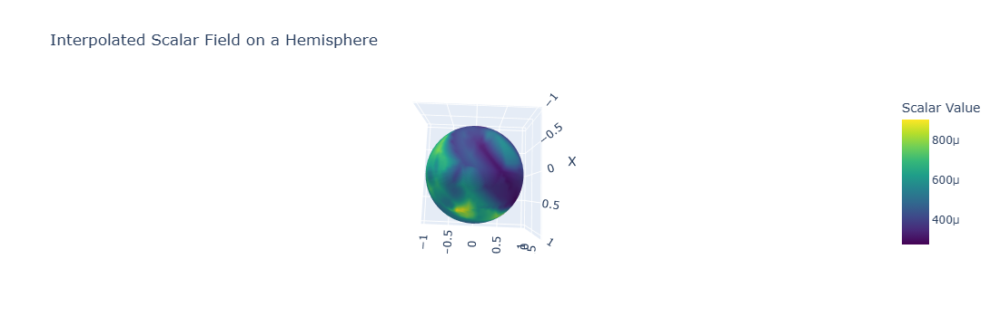

In [40]:
values = dist_mean**-2
# Step 3: Interpolate values onto the grid
# interp_points = np.column_stack((x_grid.ravel(), y_grid.ravel(), z_grid.ravel()))
interpolated_values = griddata(points_norm, values, sphere_points, method='linear')
interpolated_values = interpolated_values.reshape(x_grid.shape)

# Plot the 3D surface in Plotly
fig = go.Figure()

fig.add_trace(go.Surface(
    x=x_grid, 
    y=y_grid, 
    z=z_grid, 
    surfacecolor=interpolated_values,  # Map scalar field to surface color
    colorscale="Viridis",
    colorbar=dict(title="Scalar Value"),
    showscale=True
))

fig.update_layout(
    title="Interpolated Scalar Field on a Hemisphere",
    scene=dict(
        xaxis_title="X",
        yaxis_title="Y",
        zaxis_title="Z",
        aspectmode="data"  # Ensures correct aspect ratio
    )
)

fig.show()

In [30]:
np.max(points_norm)

1.0425558414169398

### Filter for just the deep cells
This is approximate currently, but still gets rid of most of the EVL cells

In [2]:
tracks_df_v = tracks_df.copy()
tracks_df_v[["dx", "dy", "dz"]] = tracks_df_v.loc[:, ["track_id", "x", "y", "z"]].groupby(["track_id"]).diff()
tracks_df_v["v"] = np.sqrt(tracks_df_v["dx"]**2 + tracks_df_v["dy"]**2 + tracks_df_v["dz"]**2)
tracks_df_v = tracks_df_v.loc[:, ["track_id", "v"]].groupby(["track_id"]).mean().reset_index()

tracks_df = tracks_df.merge(tracks_df_v, how="left", on="track_id")

tracks_df.head()

,track_id,t,z,y,x,id,parent_track_id,parent_id,volume,gmm_label,gmm0_prob,gmm1_prob,gmm_logL,v
0,1,0,5.0,58.0,441.0,1000001,-1,-1,3324.375,0.0,0.633889,0.366111,-2.073905,0.812908
1,1,1,5.0,58.0,441.0,2000001,-1,1000001,3587.625,0.0,0.633889,0.366111,-2.073905,0.812908
2,1,2,5.0,57.0,441.0,3000001,-1,2000001,3439.125,0.0,0.633889,0.366111,-2.073905,0.812908
3,1,3,5.0,57.0,441.0,4000001,-1,3000001,3206.250,0.0,0.633889,0.366111,-2.073905,0.812908
4,1,4,5.0,56.0,440.0,5000001,-1,4000001,3196.125,0.0,0.633889,0.366111,-2.073905,0.812908


In [4]:
gmm_filter = tracks_df["gmm0_prob"] >= 0.5 # use probs from GMM
vel_filter0 = tracks_df["v"] >= 2 # add fast-but-large nuclei. In practice most of these look like deep cells
vel_filter1 = tracks_df["v"] <= 0.2 # remove these

deep_filter = (gmm_filter | vel_filter0) & (~vel_filter1)

deep_tracks_df = tracks_df.loc[deep_filter, :].copy()
deep_tracks_df.shape

(468829, 14)

## Look at initial positions of deep cells

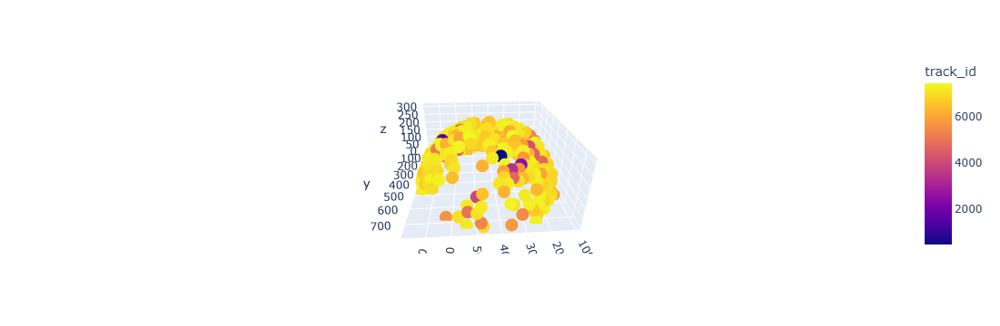

In [12]:
import plotly.express as px
t_max = 900

fig = px.scatter_3d(deep_tracks_df.loc[deep_tracks_df["t"]==t_max, :], x="x", y="y", z="z", color="track_id")
fig.show()

In [15]:
np.mean(deep_tracks_df.loc[deep_tracks_df["t"]==t_max, "parent_track_id"] > 0)

0.05

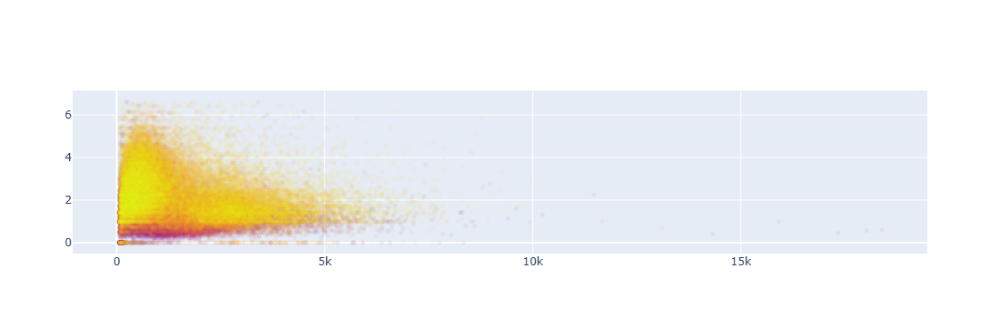

In [9]:
fig = go.Figure(go.Scatter(
        x = tracks_df_v["Volume"],
        y = tracks_df_v["v"],
        mode="markers",
        marker=dict(size=5, opacity=0.05, color=tracks_df_v["time_group"])
        # colorscale = 'Blues'
))

fig.show()

In [22]:
from sklearn.cluster import KMeans, dbscan
vv_array = tracks_df_v[["v", "Volume"]].to_numpy()
vv_array = vv_array - np.mean(vv_array, axis=0)
vv_array = np.divide(vv_array, np.percentile(np.abs(vv_array), 90, axis=0))

core, labels = dbscan(vv_array, eps=3,  min_samples = 25)

KeyboardInterrupt: 

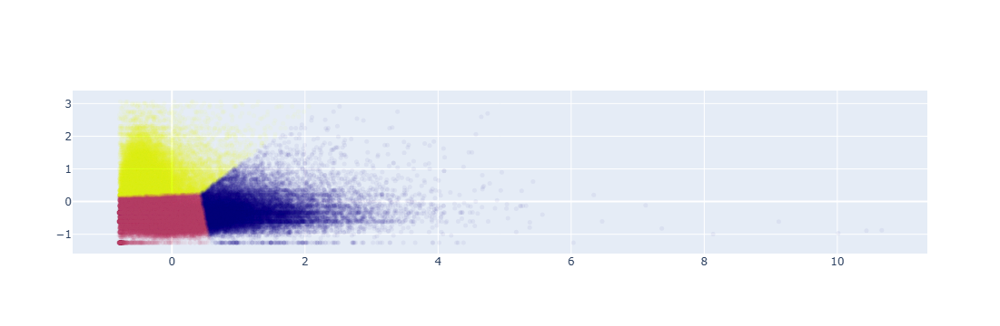

In [21]:
fig = go.Figure(go.Scatter(
        x = vv_array[:, 1],
        y = vv_array[:, 0],
        mode="markers",
        marker=dict(size=5, opacity=0.05, color=labels)
        # colorscale = 'Blues'
))

fig.show()

In [18]:
vv_array

array([[-0.26215979, -0.01855563],
       [-0.23075368, -0.02337266],
       [-0.15304615, -0.03993427],
       ...,
       [ 0.01544232,  0.05679725],
       [ 0.06560636, -0.02674361],
       [ 0.11095812, -0.06438097]])